# Reproduce tweakreg's catalog making

Nov 7, 2023: tweakreg is identifying sources where there aren't in the 1182 data.  Why?

In [239]:
from jwst.tweakreg.tweakreg_catalog import make_tweakreg_catalog
from jwst.datamodels import ModelContainer
import os

In [240]:
import warnings
warnings.simplefilter('ignore')

In [241]:
from astropy import units as u, constants
from astropy.coordinates import SkyCoord
from astropy import visualization

In [242]:
from astropy.io import fits

In [243]:
import asdf

In [244]:
from jwst.tweakreg.utils import adjust_wcs

In [245]:
from astropy.wcs import WCS

In [246]:
import json

In [247]:
import glob

In [248]:
from astropy import units as u

In [249]:
basepath = '/orange/adamginsburg/jwst/brick'

In [250]:
os.chdir(basepath)

In [251]:
ls F444W/pipeline/jw01182-o004_20230909t114334_image2_00001*json

F444W/pipeline/jw01182-o004_20230909t114334_image2_00001_asn.json


In [252]:
asn_filename = 'F444W/pipeline/jw02221-o001_20221007t121022_image3_001_nrca_asn.json'
asn_filename = 'F444W/pipeline/jw01182-o004_20230909t114334_image3_00001_merged_asn.json'
asn_filename = 'F444W/pipeline/jw01182-o004_20230909t114334_image2_00001_asn.json'
images = ModelContainer(asn_filename)
im0 = images[0]
im0

<ImageModel(2048, 2048) from jw01182004002_04101_00012_nrcblong_rate.fits>

In [253]:
kernel_fwhm = 2.5 # default; is this overridden anywhere?
kernel_fwhm = 1.91 # set in the tweakreg params, maybe from the json file?
kernel_fwhm = 2.302 # from fwhm_table
cat = make_tweakreg_catalog(im0, kernel_fwhm, snr_threshold=5, brightest=500, 
                            **{ 'sharplo': 0.3, 'sharphi': 0.9,
                               'roundlo': -0.25, 'roundhi': 0.25, })
len(cat)

2023-11-14 08:44:46,538 - stpipe - INFO - In make_tweakreg_catalog, brightest = 500
2023-11-14 08:44:47,490 - stpipe - INFO - In make_tweakreg_catalog, brightest = 500.  len(sources) = 500


500

In [254]:
%matplotlib inline
import pylab as pl
import numpy as np
from astropy.visualization import simple_norm

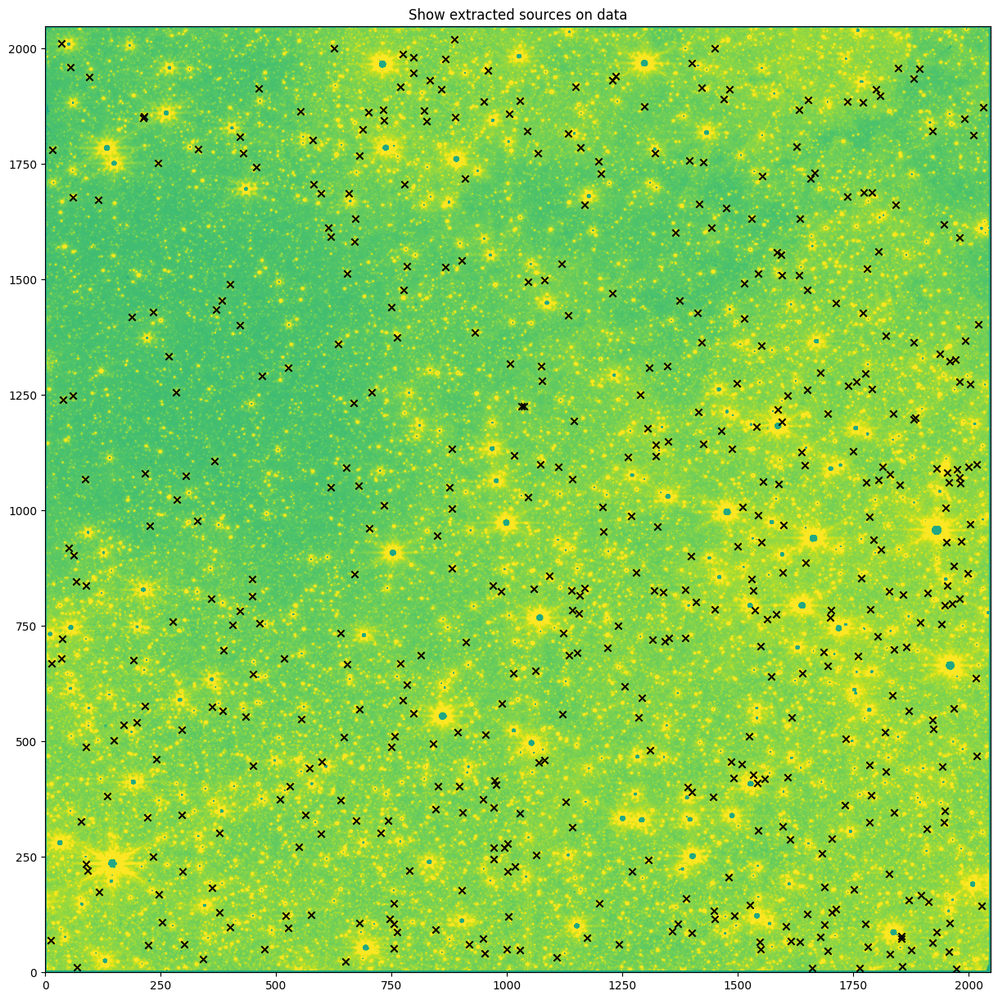

In [255]:
pl.figure(figsize=(15,15))
pl.imshow(np.nan_to_num(im0.data), norm=simple_norm(im0.data, stretch='log', min_cut=-10, max_cut=150), origin='lower')
pl.scatter(cat['xcentroid'], cat['ycentroid'], marker='x', color='k')
pl.title("Show extracted sources on data");

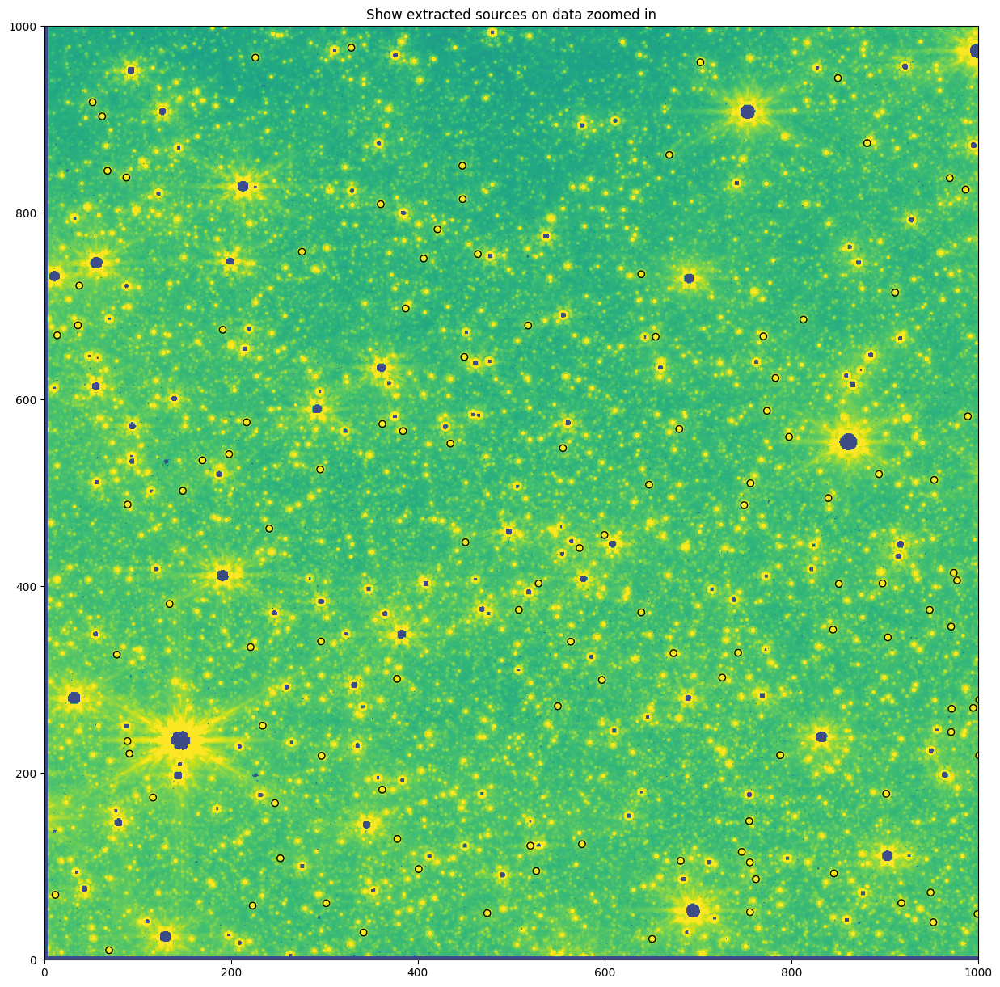

In [256]:
pl.figure(figsize=(15,15))
pl.imshow(np.nan_to_num(im0.data)[:1000, :1000], norm=simple_norm(im0.data, stretch='log', min_cut=-1, max_cut=250), origin='lower')
pl.scatter(cat['xcentroid'], cat['ycentroid'], marker='o', edgecolor='k', facecolor='none')
pl.axis([0,1000,0,1000]);
pl.title("Show extracted sources on data zoomed in");

In [257]:
ww = im0.get_fits_wcs()

In [258]:
from astropy.table import Table
abs_refcat = f'{basepath}/catalogs/crowdsource_based_nircam-long_reference_astrometric_catalog.ecsv'
reftbl = Table.read(abs_refcat)

In [259]:
reftbl[:10]

skycoord_f410m,skycoord_f405n,mag_ab_f410m,RA,DEC
"deg,deg","deg,deg",,deg,deg
SkyCoord,SkyCoord,float32,float64,float64
"266.5569360233275,-28.761313613707788","266.5569087528673,-28.76131053515299",11.29099,266.5569360233275,-28.761313613707788
"266.51382134124674,-28.747965977724906","266.513827390848,-28.747966317122323",11.425838,266.51382134124674,-28.747965977724906
"266.5537125635331,-28.66356082150327","266.5536950976412,-28.66356849511933",11.796164,266.5537125635331,-28.66356082150327
"266.5129046060225,-28.67442894923157","266.5129088242418,-28.674437206345793",11.912006,266.5129046060225,-28.67442894923157
"266.5144443926158,-28.734126940097294","266.51445293184804,-28.734135491552692",12.143967,266.5144443926158,-28.734126940097294
"266.5416637464181,-28.761725265587415","266.54165379860467,-28.761714548405063",12.154583,266.5416637464181,-28.761725265587415
"266.55394066462486,-28.761227651585642","266.5539179834564,-28.76122795833457",12.277546,266.55394066462486,-28.761227651585642
"266.5125877728232,-28.713257892008254","266.51259695471435,-28.7132675969097",12.278791,266.5125877728232,-28.713257892008254


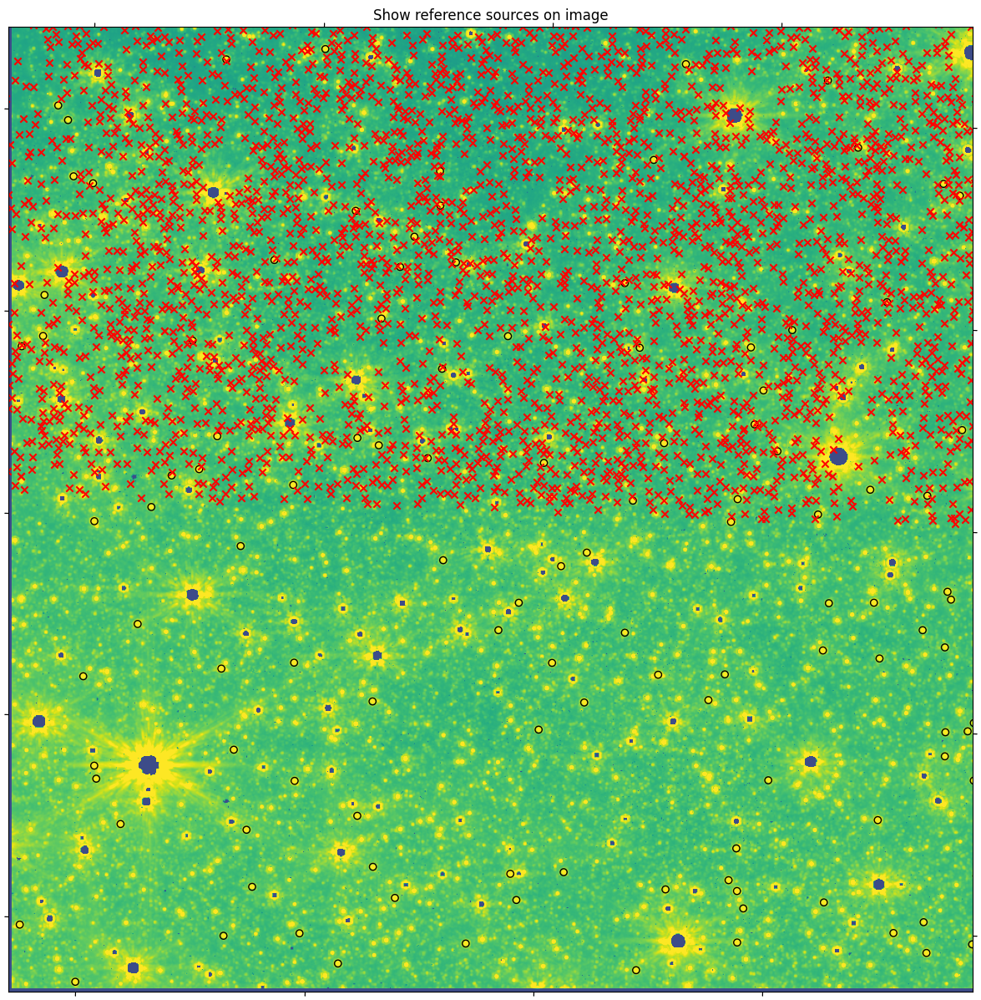

In [260]:
pl.figure(figsize=(15,15))
ax = pl.subplot(projection=ww)
ax.imshow(np.nan_to_num(im0.data)[:1000, :1000], norm=simple_norm(im0.data, stretch='log', min_cut=-1, max_cut=250), origin='lower')
ax.scatter(cat['xcentroid'], cat['ycentroid'], marker='o', edgecolor='k', facecolor='none')
ax.scatter_coord(reftbl['skycoord_f405n'], marker='x', color='r')
ax.axis([0,1000,0,1000]);
pl.title("Show reference sources on image");

## This is the checkpoint

I'm looking for x's to land close to circles.

It looks like they're super close, so abs_searchrad can be even smaller... 0.2 instead of 0.5

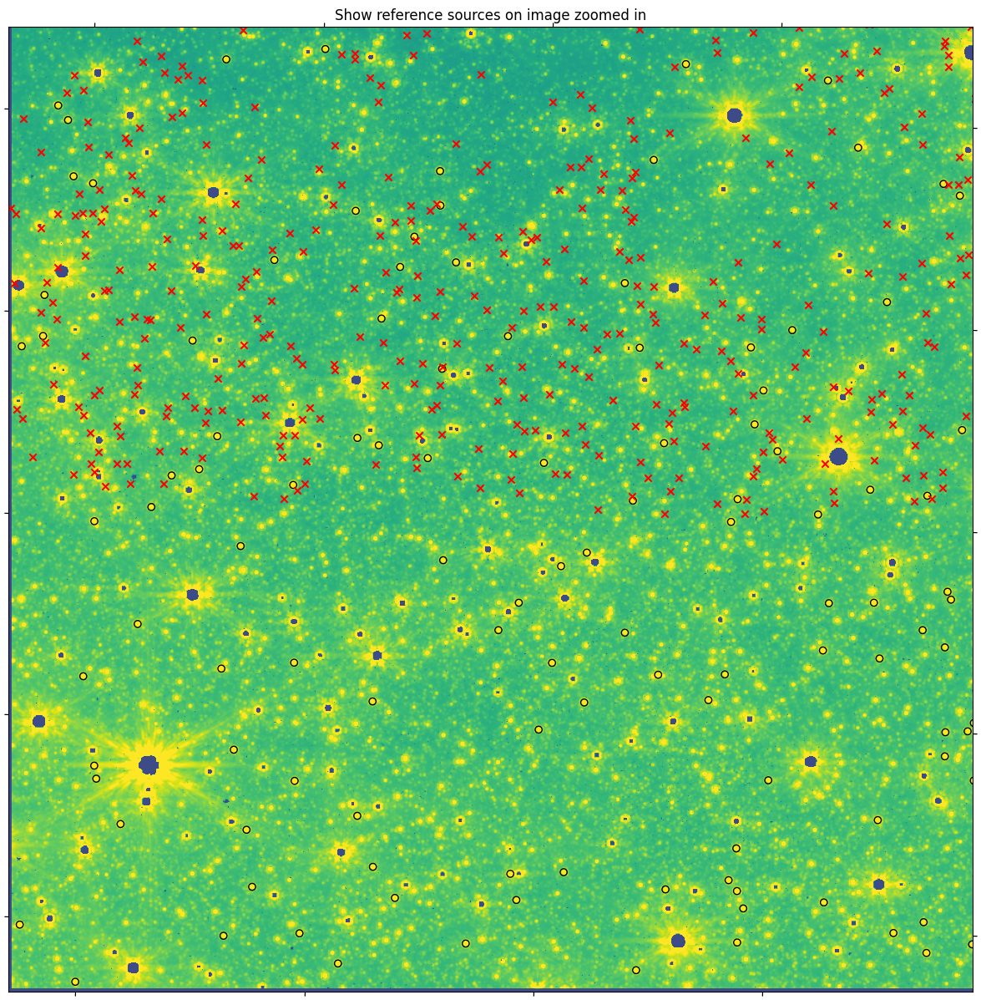

In [261]:
pl.figure(figsize=(15,15))
ax = pl.subplot(projection=ww)
ax.imshow(np.nan_to_num(im0.data)[:1000, :1000], norm=simple_norm(im0.data, stretch='log', min_cut=-1, max_cut=250), origin='lower')
ax.scatter(cat['xcentroid'], cat['ycentroid'], marker='o', edgecolor='k', facecolor='none')
ax.scatter_coord(reftbl['skycoord_f405n'][:10000], marker='x', color='r')
ax.axis([0,1000,0,1000]);
pl.title("Show reference sources on image zoomed in");

## The above went badly for `_rate`, let's check for `_cal`

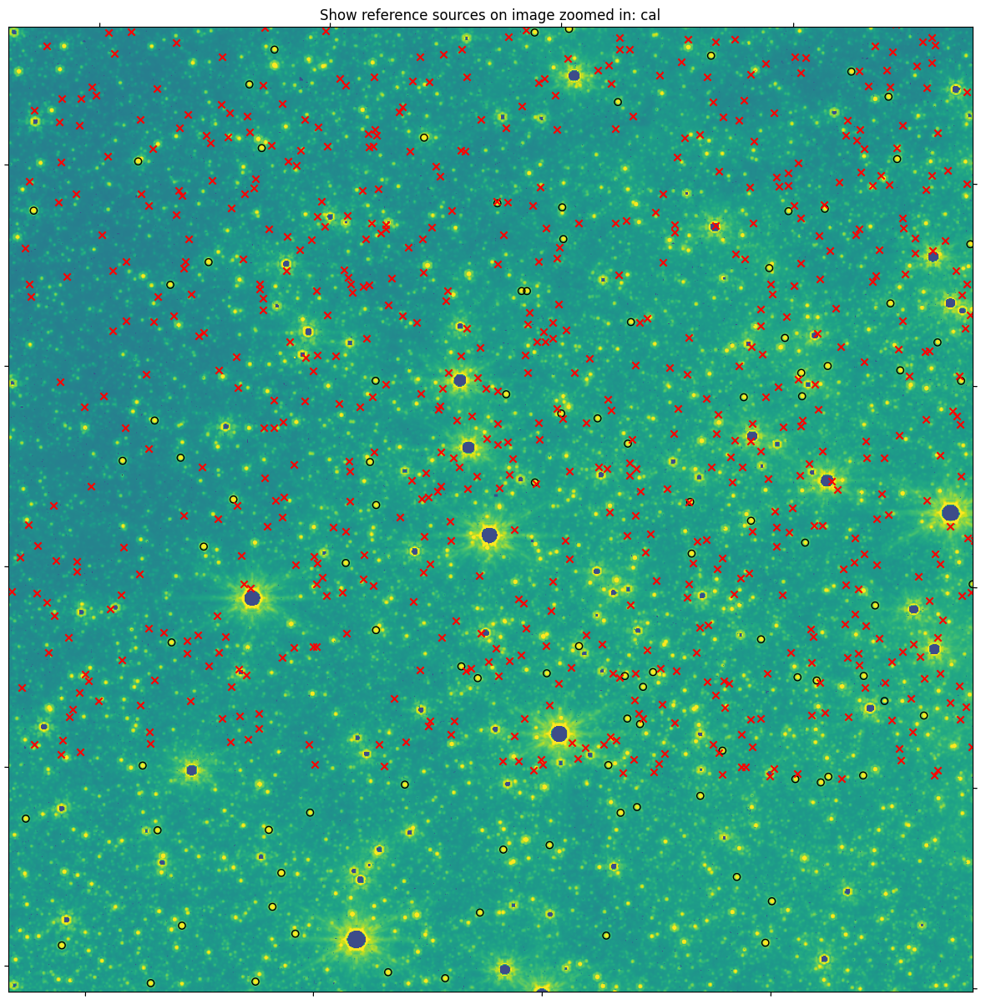

In [262]:
fh1 = fits.open('F444W/pipeline/jw01182004002_04101_00012_nrcblong_cal.fits')
im1 = fh1[1]
pl.figure(figsize=(15,15))
ax = pl.subplot(projection=WCS(im1.header)[500:1500, 500:1500])
ax.imshow(np.nan_to_num(im1.data)[500:1500, 500:1500], norm=simple_norm(im1.data, stretch='log', min_cut=-1, max_cut=250), origin='lower')
ax.scatter(cat['xcentroid']-500, cat['ycentroid']-500, marker='o', edgecolor='k', facecolor='none')
ax.scatter_coord(reftbl['skycoord_f405n'][:10000], marker='x', color='r')
ax.axis([0,1000,0,1000]);
pl.title("Show reference sources on image zoomed in: cal");

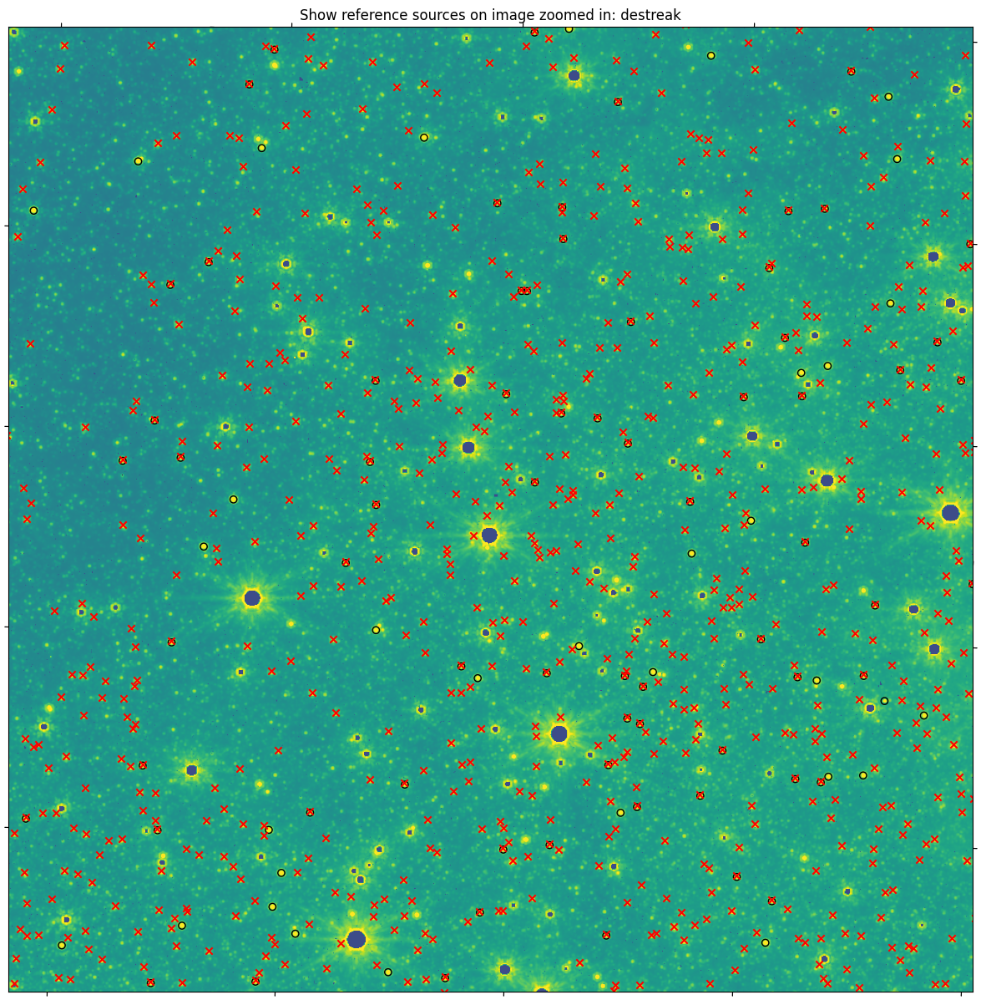

In [263]:
fh1 = fits.open('F444W/pipeline/jw01182004002_04101_00012_nrcblong_destreak.fits')
im1 = fh1[1]
pl.figure(figsize=(15,15))
ax = pl.subplot(projection=WCS(im1.header)[500:1500, 500:1500])
ax.imshow(np.nan_to_num(im1.data)[500:1500, 500:1500], norm=simple_norm(im1.data, stretch='log', min_cut=-1, max_cut=250), origin='lower')
ax.scatter(cat['xcentroid']-500, cat['ycentroid']-500, marker='o', edgecolor='k', facecolor='none')
ax.scatter_coord(reftbl['skycoord_f405n'][:10000], marker='x', color='r')
ax.axis([0,1000,0,1000]);
pl.title("Show reference sources on image zoomed in: destreak");

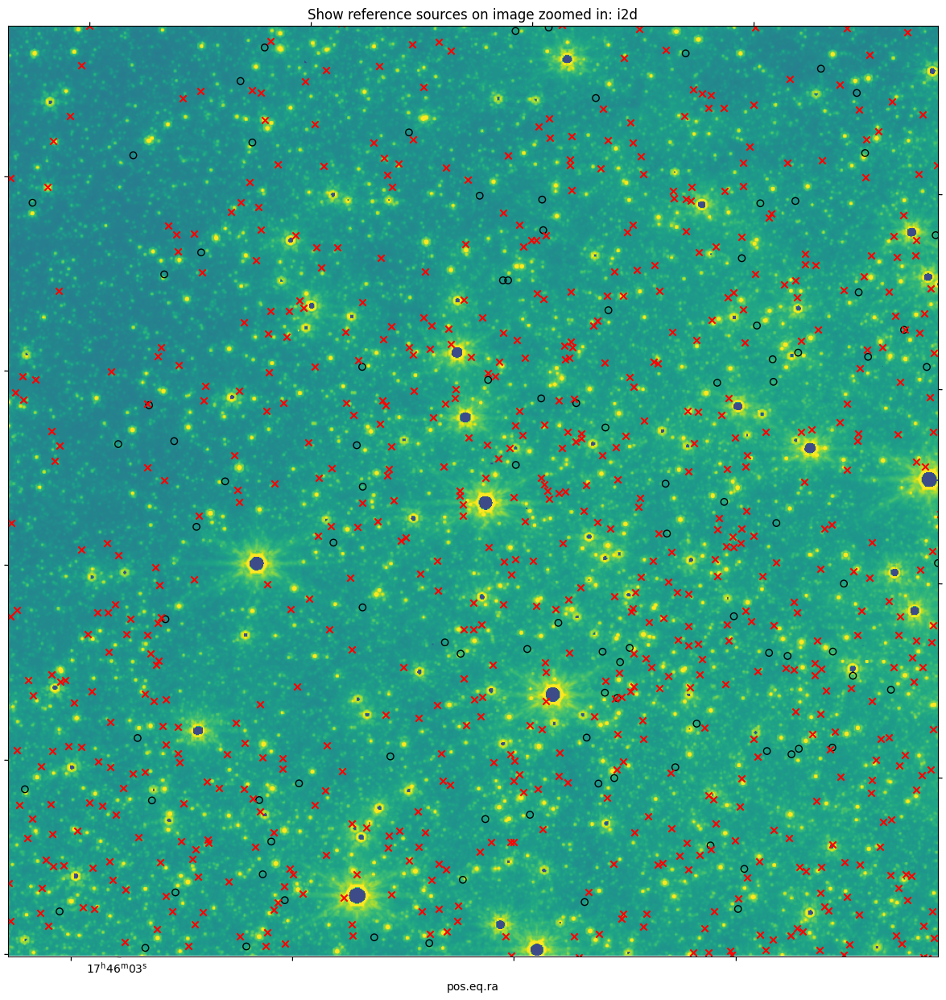

In [264]:
fh1 = fits.open('F444W/pipeline/jw01182004002_04101_00012_nrcblong_i2d.fits')
im1 = fh1[1]
pl.figure(figsize=(15,15))
ax = pl.subplot(projection=WCS(im1.header)[500:1500, 500:1500])
ax.imshow(np.nan_to_num(im1.data)[500:1500, 500:1500], norm=simple_norm(im1.data, stretch='log', min_cut=-1, max_cut=250), origin='lower')
ax.scatter(cat['xcentroid']-500, cat['ycentroid']-500, marker='o', edgecolor='k', facecolor='none')
ax.scatter_coord(reftbl['skycoord_f405n'][:10000], marker='x', color='r')
ax.axis([0,1000,0,1000]);
pl.title("Show reference sources on image zoomed in: i2d");

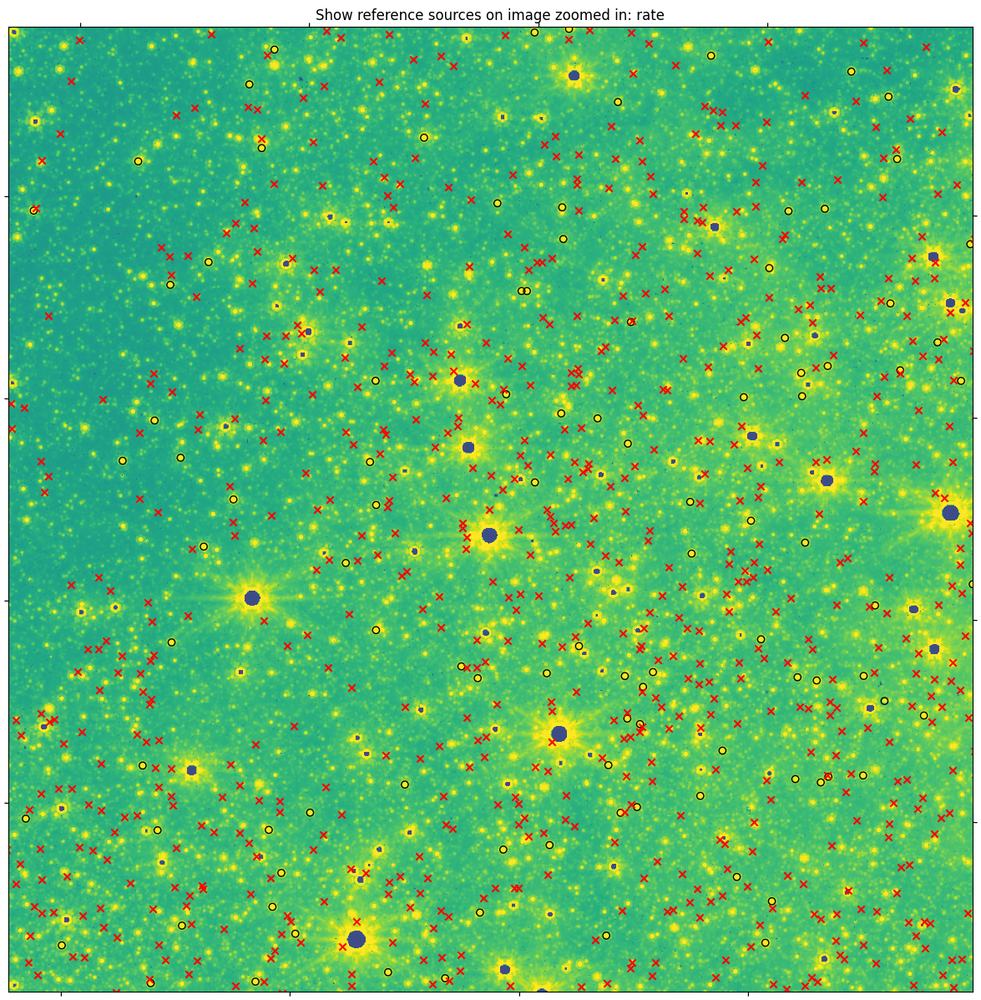

In [265]:
fh1 = fits.open('F444W/pipeline/jw01182004002_04101_00012_nrcblong_rate.fits')
im1 = fh1[1]
pl.figure(figsize=(15,15))
ax = pl.subplot(projection=WCS(im1.header)[500:1500, 500:1500])
ax.imshow(np.nan_to_num(im1.data)[500:1500, 500:1500], norm=simple_norm(im1.data, stretch='log', min_cut=-1, max_cut=250), origin='lower')
ax.scatter(cat['xcentroid']-500, cat['ycentroid']-500, marker='o', edgecolor='k', facecolor='none')
ax.scatter_coord(reftbl['skycoord_f405n'][:10000], marker='x', color='r')
ax.axis([0,1000,0,1000]);
pl.title("Show reference sources on image zoomed in: rate");

In [266]:
for ext in fh1:
    try:
        print(ext, ext.header['CRVAL1'])
    except:
        continue

<astropy.io.fits.hdu.image.ImageHDU object at 0x14c75e5a2760> 266.5233911983457


In [189]:
import asdf
print(asdf.__version__)
asdf.open('F356W/pipeline/jw01182004001_02101_00001_nrcalong_cal.fits')

2.15.1


## Load offsets table

In [135]:
offsets_tbl = Table.read(f'{basepath}/offsets/Offsets_JWST_Brick1182.csv')
offsets_tbl[:2]

Filename,Test,Filename_1,Visit,Group,Exposure,Module,IGNORE,dra (arcsec),ddec (arcsec),Filter,Notes
str95,str48,str48,str13,int64,int64,str8,str13,float64,float64,str5,str4
/orange/adamginsburg/jwst/brick/F444W/pipeline/jw01182004001_04101_00001_nrcalong_destreak.fits,jw01182004001_04101_00001_nrcalong_destreak.fits,jw01182004001_04101_00001_nrcalong_destreak.fits,jw01182004001,4101,1,nrcalong,destreak.fits,-17.5,13.5,F444W,none
/orange/adamginsburg/jwst/brick/F444W/pipeline/jw01182004001_04101_00002_nrcalong_destreak.fits,jw01182004001_04101_00002_nrcalong_destreak.fits,jw01182004001_04101_00002_nrcalong_destreak.fits,jw01182004001,4101,2,nrcalong,destreak.fits,-17.5,13.5,F444W,none


In [136]:
fh = fits.open("F444W/pipeline/jw01182004002_04101_00012_nrcalong_destreak.fits")

### Load file for testing

In [141]:
asn_file = 'F444W/pipeline/jw01182-o004_20230909t114334_image2_00346_asn.json' #top
asn_file = 'F444W/pipeline/jw01182-o004_20230909t114334_image2_00001_asn.json'
#for asn_file in glob.glob('F444W/pipeline/jw01182-o004_20230909t114334_*.json'):
with open(asn_file) as f_obj:
    asn_data = json.load(f_obj)
member = asn_data['products'][0]['members'][0]
member['expname'] = member['expname'].replace("rate","destreak")
print(asn_file, member['expname'].split('/')[-1], member['expname'])

F444W/pipeline/jw01182-o004_20230909t114334_image2_00001_asn.json jw01182004002_04101_00012_nrcblong_destreak.fits jw01182004002_04101_00012_nrcblong_destreak.fits


In [142]:
int(member['expname'].split("_")[-3])

12

In [143]:
'jw01182004001_04101_00001_nrcalong_cal.fits'.split("_")[-3]

'00001'

In [148]:
member['expname'] = 'jw01182004001_04101_00001_nrcalong_destreak.fits'
match = ((offsets_tbl['Visit'] == 'jw01182004001') &
         #(offsets_tbl['Group'] == '4101') &
         (offsets_tbl['Exposure'] == int(member['expname'].split("_")[-3])) &
         (offsets_tbl['Module'] == member['expname'].split("_")[-2])
         )
offsets_tbl[match]

Filename,Test,Filename_1,Visit,Group,Exposure,Module,IGNORE,dra (arcsec),ddec (arcsec),Filter,Notes
str95,str48,str48,str13,int64,int64,str8,str13,float64,float64,str5,str4
/orange/adamginsburg/jwst/brick/F444W/pipeline/jw01182004001_04101_00001_nrcalong_destreak.fits,jw01182004001_04101_00001_nrcalong_destreak.fits,jw01182004001_04101_00001_nrcalong_destreak.fits,jw01182004001,4101,1,nrcalong,destreak.fits,-17.5,13.5,F444W,none
/orange/adamginsburg/jwst/brick/F356W/pipeline/jw01182004001_02101_00001_nrcalong_destreak.fits,jw01182004001_02101_00001_nrcalong_destreak.fits,jw01182004001_02101_00001_nrcalong_destreak.fits,jw01182004001,2101,1,nrcalong,destreak.fits,-17.5,13.5,F356W,none


In [149]:
row = offsets_tbl[member['expname'].split('/')[-1] == offsets_tbl['Filename_1']]
row['Module']

nrcalong


In [150]:
align_image = member['expname']
offsets_tbl = Table.read(f'{basepath}/offsets/Offsets_JWST_Brick1182.csv')
row = offsets_tbl[member['expname'].split('/')[-1] == offsets_tbl['Filename_1']]
print(row)
print(f'Running manual align for {row["Group"][0]} {row["Module"][0]} {row["Exposure"][0]}.')
rashift = float(row['dra (arcsec)'])*u.arcsec
decshift = float(row['ddec (arcsec)'])*u.arcsec

                                            Filename                                                                  Test                                          Filename_1                        Visit     ... ddec (arcsec) Filter Notes
----------------------------------------------------------------------------------------------- ------------------------------------------------ ------------------------------------------------ ------------- ... ------------- ------ -----
/orange/adamginsburg/jwst/brick/F444W/pipeline/jw01182004001_04101_00001_nrcalong_destreak.fits jw01182004001_04101_00001_nrcalong_destreak.fits jw01182004001_04101_00001_nrcalong_destreak.fits jw01182004001 ...          13.5  F444W  none
Running manual align for 4101 nrcalong 1.


In [271]:
filtername = 'F444W'
align_image = 'jw01182004002_02101_00001_nrcalong_destreak.fits'
print(f"Running manual align for merged data (1182 + 004): {align_image}")
offsets_tbl = Table.read(f'{basepath}/offsets/Offsets_JWST_Brick1182.csv')
exposure = int(member['expname'].split("_")[-3])
thismodule = member['expname'].split("_")[-2].strip('1234')
visit = member['expname'].split("_")[0]
print(exposure, thismodule)
match = ((offsets_tbl['Visit'] == 'jw01182004001') &
         (offsets_tbl['Exposure'] == exposure) &
         (offsets_tbl['Module'] == thismodule) &
         (offsets_tbl['Filter'] == filtername)
         )
if match.sum() != 1:
    raise ValueError(f"too many or too few matches for {member} (match.sum() = {match.sum()}).  exposure={exposure}, thismodule={thismodule}, filtername={filtername}")
row = offsets_tbl[match]
print(f'Running manual align for merged for {row["Group"][0]} {row["Module"][0]} {row["Exposure"][0]}.')
rashift = float(row['dra (arcsec)'][0])*u.arcsec
decshift = float(row['ddec (arcsec)'][0])*u.arcsec
print(f"Shift for {align_image} is {rashift}, {decshift}")

Running manual align for merged data (1182 + 004): jw01182004002_02101_00001_nrcalong_destreak.fits
1 nrcalong
Running manual align for merged for 4101 nrcalong 1.
Shift for jw01182004002_02101_00001_nrcalong_destreak.fits is -17.5 arcsec, 13.5 arcsec


In [151]:
member['expname']

'jw01182004001_04101_00001_nrcalong_destreak.fits'

In [152]:
align_image = f"{basepath}/F444W/pipeline/{member['expname']}"
align_image

'/orange/adamginsburg/jwst/brick/F444W/pipeline/jw01182004001_04101_00001_nrcalong_destreak.fits'

In [ ]:
# comparison from above jw01182004002_04101_00012_nrcblong

In [153]:
rashift, decshift

(<Quantity -17.5 arcsec>, <Quantity 13.5 arcsec>)

### Test code (integrated into pipeline)

In [46]:
rashift, decshift = 2.0*u.arcsec, 1.0*u.arcsec

In [154]:
# FITS header
# load the header from a file we won't modify
align_fits = fits.open(align_image.replace("destreak", "cal"))
print(align_fits[1].header['CRVAL1'], align_fits[1].header['CRVAL2'])
align_fits[1].header['CRVAL1'] += rashift.to(u.deg).value
align_fits[1].header['CRVAL2'] += decshift.to(u.deg).value
print(align_fits[1].header['CRVAL1'], align_fits[1].header['CRVAL2'])
#align_fits.writeto(align_image, overwrite=True)

266.55644946973 -28.718736278771
266.5515883586189 -28.714986278771


In [48]:
# as of 11/7/2023, this is integrated into the pipeline and shouldn't be re-run except during debugging
# ASDF header
fa = asdf.open(align_image.replace("destreak", "cal"))
wcsobj = fa.tree['meta']['wcs']
ww = adjust_wcs(wcsobj, delta_ra=rashift, delta_dec=decshift)
tree = fa.tree
tree['meta']['wcs'] = ww
fa = asdf.fits_embed.AsdfInFits(align_fits, tree)
align_fits.writeto(align_image, overwrite=True)

# FITS header
align_fits = fits.open(align_image.replace("destreak", "cal"))
print(align_fits[1].header['CRVAL1'], align_fits[1].header['CRVAL2'],)
align_fits[1].header.update(ww.to_fits()[0])
print(align_fits[1].header['CRVAL1'], align_fits[1].header['CRVAL2'],)
align_fits.writeto(align_image, overwrite=True)

266.52338793814 -28.67945944451
266.52394349371 -28.679181666732


### Visualizations: slice appropriate for bottom image

(-0.5, 499.5, -0.5, 499.5)

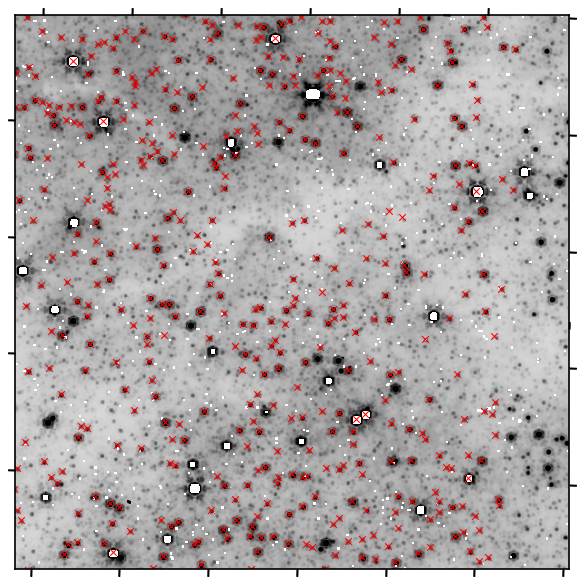

In [49]:
fh = fits.open(align_image)
ww = WCS(fh[1].header)
fig = pl.figure(dpi=150)
ax = pl.subplot(projection=ww[1500:2000,1500:2000])
ax.imshow(fh[1].data[1500:2000,1500:2000], cmap='gray_r',
          norm=simple_norm(fh[1].data[1500:2000,1500:2000], min_cut=-1, max_cut=100, stretch='asinh'))
axlims = ax.axis()
ax.scatter_coord(reftbl['skycoord_f405n'][reftbl['mag_ab_f410m'] < 18], marker='x', color='r', linewidth=0.5, s=10)
ax.axis(axlims)

### Visualizations: slice appropriate for top image

In [ ]:
prealign_image = align_image.replace('destreak', 'cal')

fh = fits.open(align_image)
ww = WCS(fh[1].header)
fig = pl.figure(dpi=150, figsize=(12,6))
ax = pl.subplot(1,2,1,projection=ww[:500,:500])
ax.imshow(fh[1].data[:500,:500], cmap='gray_r',
          norm=simple_norm(fh[1].data[:500,:500], min_cut=-1, max_cut=100, stretch='asinh'))
axlims = ax.axis()
ax.scatter_coord(reftbl['skycoord_f405n'][reftbl['mag_ab_f410m'] < 18], marker='x', color='r', linewidth=0.75, s=15)
ax.axis(axlims)

fh = fits.open(prealign_image)
ww = WCS(fh[1].header)
ax = pl.subplot(1,2,2,projection=ww[:500,:500])
ax.imshow(fh[1].data[:500,:500], cmap='gray_r',
          norm=simple_norm(fh[1].data[:500,:500], min_cut=-1, max_cut=100, stretch='asinh'))
axlims = ax.axis()
crds = reftbl['skycoord_f405n'][reftbl['mag_ab_f410m'] < 18]
crds = SkyCoord(crds.ra - rashift, crds.dec - decshift, frame='icrs')
ax.scatter_coord(crds,
                 marker='x', color='r', linewidth=0.75, s=15)

cen = ww[:500,:500].pixel_to_world(250, 250)
pl.plot(u.Quantity([cen.ra, cen.ra - rashift]),
        u.Quantity([cen.dec, cen.dec - decshift]),
        'r', transform=ax.get_transform('world'))

ax.axis(axlims);
pl.subplots_adjust(hspace=0, wspace=0);

In [ ]:
rashift, decshift

### pure debug: set ra/dec shift by hand

In [ ]:
slc = slice(0,500), slice(1542-250,1542+250)

In [ ]:
rashift = -17.5*u.arcsec
decshift = 13.5*u.arcsec
fh = fits.open(prealign_image)
ww = WCS(fh[1].header)
fig = pl.figure(dpi=150, figsize=(10,10))
ax = pl.subplot(1,2,2,projection=ww[slc])
ax.imshow(fh[1].data[slc], cmap='gray_r',
          norm=simple_norm(fh[1].data[slc], min_cut=-1, max_cut=100, stretch='asinh'))
axlims = ax.axis()
crds = reftbl['skycoord_f405n'][reftbl['mag_ab_f410m'] < 17]
ax.scatter_coord(crds,
                 marker='x', color='b', linewidth=0.25, s=5)
crds = SkyCoord(crds.ra - rashift, crds.dec - decshift, frame='icrs')
ax.scatter_coord(crds,
                 marker='x', color='r', linewidth=0.75, s=15)

cen = ww[slc].pixel_to_world(300, 300)
pl.plot(u.Quantity([cen.ra, cen.ra - rashift]),
        u.Quantity([cen.dec, cen.dec - decshift]),
        'r', transform=ax.get_transform('world'))

ax.axis(axlims);
pl.subplots_adjust(hspace=0, wspace=0);

In [ ]:
rashift = -17.5*u.arcsec
decshift = 13.5*u.arcsec
fh = fits.open(prealign_image)
ww = WCS(fh[1].header)
ww.wcs.crval[0] += rashift.to(u.deg).value
ww.wcs.crval[1] += decshift.to(u.deg).value
fig = pl.figure(dpi=150, figsize=(10,10))
ax = pl.subplot(1,2,2,projection=ww[slc])
ax.imshow(fh[1].data[slc], cmap='gray_r',
          norm=simple_norm(fh[1].data[slc], min_cut=-1, max_cut=100, stretch='asinh'))
axlims = ax.axis()
crds = reftbl['skycoord_f405n'][reftbl['mag_ab_f410m'] < 17]
ax.scatter_coord(crds,
                 marker='x', color='lime', linewidth=0.5, s=5)
# crds = SkyCoord(crds.ra - rashift, crds.dec - decshift, frame='icrs')
# ax.scatter_coord(crds,
#                  marker='x', color='r', linewidth=0.75, s=15)

cen = ww[slc].pixel_to_world(300, 300)
pl.plot(u.Quantity([cen.ra, cen.ra - rashift]),
        u.Quantity([cen.dec, cen.dec - decshift]),
        'r', transform=ax.get_transform('world'))

ax.axis(axlims);
pl.subplots_adjust(hspace=0, wspace=0);

In [ ]:
print(f"Before shift, crval={wcsobj.to_fits()[0]['CRVAL1']}, {wcsobj.to_fits()[0]['CRVAL2']}")

## Verify some individual examples

In [ ]:
align_image = 'F444W/pipeline/jw01182004001_04101_00007_nrcalong_destreak.fits'
fh = fits.open(align_image)
ww = WCS(fh[1].header)
fig = pl.figure(dpi=150, figsize=(12,6))
ax = pl.subplot(projection=ww[:500,:500])
ax.imshow(fh[1].data[:500,:500], cmap='gray_r',
          norm=simple_norm(fh[1].data[:500,:500], min_cut=-1, max_cut=100, stretch='asinh'))
axlims = ax.axis()
ax.scatter_coord(reftbl['skycoord_f405n'][reftbl['mag_ab_f410m'] < 18], marker='x', color='r', linewidth=0.75, s=15)
ax.axis(axlims)

In [ ]:
align_image = 'F444W/pipeline/jw01182004001_04101_00001_nrcalong_destreak.fits'
fh = fits.open(align_image)
ww = WCS(fh[1].header)
fig = pl.figure(dpi=150, figsize=(12,6))
ax = pl.subplot(projection=ww[:500,:500])
ax.imshow(fh[1].data[:500,:500], cmap='gray_r',
          norm=simple_norm(fh[1].data[:500,:500], min_cut=-1, max_cut=100, stretch='asinh'))
axlims = ax.axis()
ax.scatter_coord(reftbl['skycoord_f405n'][reftbl['mag_ab_f410m'] < 18], marker='x', color='r', linewidth=0.75, s=15)
ax.axis(axlims)

ax.axis(axlims);

In [ ]:
align_image = 'F444W/pipeline/jw01182004002_04101_00006_nrcalong_destreak.fits'
fh = fits.open(align_image)
ww = WCS(fh[1].header)
fig = pl.figure(dpi=150, figsize=(12,6))
ax = pl.subplot(projection=ww[500:1000,500:1000])
ax.imshow(fh[1].data[500:1000,500:1000], cmap='gray_r',
          norm=simple_norm(fh[1].data[500:1000,500:1000], min_cut=-1, max_cut=100, stretch='asinh'))
axlims = ax.axis()
ax.scatter_coord(reftbl['skycoord_f405n'][reftbl['mag_ab_f410m'] < 18], marker='x', color='r', linewidth=0.75, s=15)
ax.axis(axlims);

In [ ]:
# with asdf
align_image = 'F444W/pipeline/jw01182004002_04101_00006_nrcalong_destreak.fits'
fh = fits.open(align_image)
fa = asdf.open(align_image)
ww = fa.tree['meta']['wcs']
#ww = adjust_wcs(ww, delta_ra=rashift, delta_dec=decshift)
fig = pl.figure(dpi=150, figsize=(12,6))
ax = pl.subplot(projection=ww)
ax.imshow(fh[1].data, cmap='gray_r',
          norm=simple_norm(fh[1].data, min_cut=-1, max_cut=100, stretch='asinh'))
axlims = ax.axis([500,1000,500,1000])
ax.scatter_coord(reftbl['skycoord_f405n'][reftbl['mag_ab_f410m'] < 18], marker='x', color='r', linewidth=0.75, s=15)
ax.axis(axlims);

In [ ]:
# with asdf adjusted
align_image = 'F444W/pipeline/jw01182004002_04101_00006_nrcalong_destreak.fits'
fh = fits.open(align_image)
fa = asdf.open(align_image)
ww = fa.tree['meta']['wcs']
ww = adjust_wcs(ww, delta_ra=rashift, delta_dec=decshift)
fig = pl.figure(dpi=150, figsize=(12,6))
ax = pl.subplot(projection=ww)
ax.imshow(fh[1].data, cmap='gray_r',
          norm=simple_norm(fh[1].data, min_cut=-1, max_cut=100, stretch='asinh'))
axlims = ax.axis([500,1000,500,1000])
ax.scatter_coord(reftbl['skycoord_f405n'][reftbl['mag_ab_f410m'] < 18], marker='x', color='r', linewidth=0.75, s=15)
ax.axis(axlims);

In [ ]:
fa = asdf.open(align_image)
w1 = fa.tree['meta']['wcs']
w2 = adjust_wcs(w1, delta_ra=rashift, delta_dec=decshift)

In [ ]:
w1.forward_transform.parameters - w2.forward_transform.parameters

In [ ]:
w1.forward_transform.param_sets

In [ ]:
w2.forward_transform.param_sets[-1]

In [ ]:
w1.forward_transform.param_names[-1]

In [ ]:
w1.forward_transform.offset_16, w1.forward_transform.offset_17,

In [ ]:
w2.forward_transform.offset_16, w2.forward_transform.offset_17,

In [ ]:
w2.forward_transform.offset_16, w2.forward_transform.offset_17,

In [ ]:
#dict(zip(w1.forward_transform.param_names, 
#w1.forward_transform.parameters - w2.forward_transform.parameters))

In [ ]:
w1.forward_transform, w2.forward_transform

In [ ]:
fa.write_to('test.fits')

In [ ]:
fits.open('test.fits').info()

# Broken examples: outlier

In [ ]:
align_image = 'F444W/pipeline/jw01182004002_04101_00006_nrcalong_outlier_i2d.fits'
fh = fits.open(align_image)
ww = WCS(fh[1].header)
fig = pl.figure(dpi=150, figsize=(12,6))
ax = pl.subplot(projection=ww[500:1000,500:1000])
ax.imshow(fh[1].data[500:1000,500:1000], cmap='gray_r',
          norm=simple_norm(fh[1].data[500:1000,500:1000], min_cut=-1, max_cut=100, stretch='asinh'))
axlims = ax.axis()
ax.scatter_coord(reftbl['skycoord_f405n'][reftbl['mag_ab_f410m'] < 18], marker='x', color='r', linewidth=0.75, s=15)
ax.axis(axlims);

# Generic pipeline debugging

In [63]:
os.environ["CRDS_PATH"] = "/orange/adamginsburg/jwst/brick/crds/"
os.environ["CRDS_SERVER_URL"] = "https://jwst-crds.stsci.edu"
import crds

In [65]:
regionname = 'brick'
mapping = crds.rmap.load_mapping(f'/orange/adamginsburg/jwst/{regionname}/crds/mappings/jwst/jwst_nircam_pars-tweakregstep_0003.rmap')

In [69]:
filtername='F200W'
[x for x in mapping.todict()['selections'] if filtername in x]

[('NRC_IMAGE',
  'F200W',
  'CLEAR',
  '2000-01-01 00:00:00',
  'jwst_nircam_pars-tweakregstep_0036.asdf')]

In [70]:
filtername='F200W'
[x for x in mapping.todict()['selections'] if filtername in x][0][4]

'jwst_nircam_pars-tweakregstep_0036.asdf'

## The pipeline does...

 * -rw-r--r-- 1 adamginsburg adamginsburg  65M Nov  9 12:52 F200W/pipeline/jw01182004001_04101_00012_nrcb3_uncal.fits
 * -rw-r--r-- 1 adamginsburg adamginsburg  49M Nov 10 01:18 F200W/pipeline/jw01182004001_04101_00012_nrcb3_trapsfilled.fits
 * -rw-r--r-- 1 adamginsburg adamginsburg 285M Nov 10 01:18 F200W/pipeline/jw01182004001_04101_00012_nrcb3_ramp.fits
 * -rw-r--r-- 1 adamginsburg adamginsburg  81M Nov 10 01:19 F200W/pipeline/jw01182004001_04101_00012_nrcb3_rateints.fits
 * -rw-r--r-- 1 adamginsburg adamginsburg  81M Nov 10 01:19 F200W/pipeline/jw01182004001_04101_00012_nrcb3_rate.fits
 * -rw-r--r-- 1 adamginsburg adamginsburg 114M Nov 10 01:19 F200W/pipeline/jw01182004001_04101_00012_nrcb3_i2d.fits
 * -rw-r--r-- 1 adamginsburg adamginsburg 113M Nov 10 01:19 F200W/pipeline/jw01182004001_04101_00012_nrcb3_cal.fits

In [91]:
def checkhead(filename):
    fh = fits.open(filename)
    fa = asdf.open(filename)
    try:
        wcsobj = fa.tree['meta']['wcs']
        print(f"{filename}: FITS crval={fh[1].header['CRVAL1']},{fh[1].header['CRVAL2']} ; ASDF crval={wcsobj.to_fits()[0]['CRVAL1']}, {wcsobj.to_fits()[0]['CRVAL2']}, {wcsobj.forward_transform.param_sets[-1]}")
    except KeyError:
        wcsobj = fa.tree['meta']['wcsinfo']
        print(f"{filename}: FITS crval={fh[1].header['CRVAL1']},{fh[1].header['CRVAL2']} ; ASDF crval={wcsobj['crval1']}, {wcsobj['crval2']}")

In [92]:
for fn in glob.glob('F200W/pipeline/jw01182004001_04101_00012_nrcb3_*fits'):
    try:
        checkhead(fn)
    except Exception as ex:
        print(fn, type(ex), ex)

F200W/pipeline/jw01182004001_04101_00012_nrcb3_trapsfilled.fits <class 'KeyError'> 'wcsinfo'
F200W/pipeline/jw01182004001_04101_00012_nrcb3_ramp.fits: FITS crval=266.5733047270735,-28.690406137150827 ; ASDF crval=266.5733047270735, -28.690406137150827
F200W/pipeline/jw01182004001_04101_00012_nrcb3_rate.fits: FITS crval=266.5733047270735,-28.690406137150827 ; ASDF crval=266.5733047270735, -28.690406137150827
F200W/pipeline/jw01182004001_04101_00012_nrcb3_uncal.fits: FITS crval=266.5733047270735,-28.690406137150827 ; ASDF crval=266.5733047270735, -28.690406137150827
F200W/pipeline/jw01182004001_04101_00012_nrcb3_cal.fits: FITS crval=266.57332074922,-28.69039759204 ; ASDF crval=266.57332074922, -28.69039759204, [[-1.51555019e-02  1.27147541e-01  9.10791639e+01 -2.86904061e+01
  -2.66573305e+02]]
F200W/pipeline/jw01182004001_04101_00012_nrcb3_rateints.fits: FITS crval=266.5733047270735,-28.690406137150827 ; ASDF crval=266.5733047270735, -28.690406137150827
F200W/pipeline/jw01182004001_0410

In [78]:
fits.open('F200W/pipeline/jw01182004001_04101_00012_nrcb3_uncal.fits').info()

Filename: F200W/pipeline/jw01182004001_04101_00012_nrcb3_uncal.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     198   ()      
  1  SCI           1 ImageHDU        80   (2048, 2048, 7, 1)   int16 (rescales to uint16)   
  2  ZEROFRAME     1 ImageHDU        12   (2048, 2048, 1)   int16 (rescales to uint16)   
  3  GROUP         1 BinTableHDU     38   8R x 13C   [I, I, I, J, I, 26A, I, I, I, I, 36A, D, D]   
  4  INT_TIMES     1 BinTableHDU     24   1R x 7C   [J, D, D, D, D, D, D]   
  5  ASDF          1 BinTableHDU     11   1R x 1C   [8102B]   


In [90]:
asdf.open('F200W/pipeline/jw01182004001_04101_00012_nrcb3_uncal.fits').tree['meta']['wcsinfo']

{'cdelt1': 8.563647222222222e-06,
 'cdelt2': 8.588097222222223e-06,
 'crpix1': 1024.5,
 'crpix2': 1024.5,
 'crval1': 266.5733047270735,
 'crval2': -28.690406137150827,
 'ctype1': 'RA---TAN',
 'ctype2': 'DEC--TAN',
 'cunit1': 'deg',
 'cunit2': 'deg',
 'dec_ref': -28.690406137150827,
 'pc1_1': 0.011025763961712221,
 'pc1_2': 0.9999392144170868,
 'pc2_1': 0.9999392144170868,
 'pc2_2': -0.011025763961712221,
 'ra_ref': 266.5733047270735,
 'roll_ref': 91.07916387124496,
 's_region': 'POLYGON ICRS  266.563131516 -28.699145903 266.563419720 -28.681501311 266.583427540 -28.681789728 266.583250120 -28.699244949',
 'v2_ref': -54.559807,
 'v3_ref': -457.731149,
 'v3yangle': -0.44742133,
 'velosys': 29843.2,
 'vparity': -1,
 'wcsaxes': 2}

In [95]:
for fn in glob.glob('F444W/pipeline/jw01182004001_04101_00006_nrcalong*fits'):
    try:
        checkhead(fn)
    except Exception as ex:
        print(fn, type(ex), ex)

F444W/pipeline/jw01182004001_04101_00006_nrcalong_ramp.fits: FITS crval=266.55771499989726,-28.729131683319316 ; ASDF crval=266.55771499989726, -28.729131683319316
F444W/pipeline/jw01182004001_04101_00006_nrcalong_cal.fits: FITS crval=266.55771176811,-28.729131440389 ; ASDF crval=266.55771176811, -28.729131440389, [[ 2.38720272e-02  1.37086292e-01  9.10868124e+01 -2.87291317e+01
  -2.66557715e+02]]
F444W/pipeline/jw01182004001_04101_00006_nrcalong_uncal.fits: FITS crval=266.55771499989726,-28.729131683319316 ; ASDF crval=266.55771499989726, -28.729131683319316
F444W/pipeline/jw01182004001_04101_00006_nrcalong_outlier_i2d.fits: FITS crval=266.55644946973,-28.718736278771 ; ASDF crval=266.53475297458, -28.724872209507, [180.]
F444W/pipeline/jw01182004001_04101_00006_nrcalong_rate.fits: FITS crval=266.55771499989726,-28.729131683319316 ; ASDF crval=266.55771499989726, -28.729131683319316
F444W/pipeline/jw01182004001_04101_00006_nrcalong_cal_cat.fits <class 'KeyError'> 'meta'
F444W/pipelin

In [98]:
fits.getheader?

Signature: fits.getheader(filename, *args, **kwargs)
Docstring:
Get the header from an HDU of a FITS file.

Parameters
----------
filename : path-like or file-like
    File to get header from.  If an opened file object, its mode
    must be one of the following rb, rb+, or ab+).

ext, extname, extver
    The rest of the arguments are for HDU specification.  See the
    `getdata` documentation for explanations/examples.
**kwargs
    Any additional keyword arguments to be passed to
    `astropy.io.fits.open`.

Returns
-------
header : `Header` object
File:      /orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/astropy/io/fits/convenience.py
Type:      function

In [97]:
fits.open('F444W/pipeline/jw01182004001_04101_00006_nrcalong_cal.fits')[1].header['RAOFFSET']

KeyError: "Keyword 'RAOFFSET' not found."

## ASDF debug

In [190]:
import asdf

In [203]:
af = asdf.open('F444W/pipeline/jw01182004001_04101_00007_nrcalong_destreak.fits')
af.write_to('test.fits', overwrite=True)

In [204]:
af = asdf.open('F444W/pipeline/jw01182004001_04101_00007_nrcalong_destreak.fits')
af.write_to('test.fits')

OSError: File test.fits already exists. If you mean to replace it then use the argument "overwrite=True".

In [194]:
from stdatamodels import asdf_in_fits

In [272]:
import stdatamodels.jwst.datamodels

In [315]:
af = stdatamodels.jwst.datamodels.open('F444W/pipeline/jw01182004001_04101_00007_nrcalong_destreak.fits')
af.info()
meta = af['meta']
meta.wcs

root (AsdfObject)
├─asdf_library (Software)
│ ├─author (str): The ASDF Developers
│ ├─homepage (str): http://github.com/asdf-format/asdf
│ ├─name (str): asdf
│ └─version (str): 2.15.1
├─history (dict)
│ └─extensions (list) ...
├─_fits_hash (str): d582cf2a900f78491144a22d00849623c7c9c776319b1c6a1e9d1dfbd9994e66
├─area (ndarray): shape=(2048, 2048), dtype=float32
├─data (ndarray): shape=(2048, 2048), dtype=float32
├─dq (ndarray): shape=(2048, 2048), dtype=uint32
├─err (ndarray): shape=(2048, 2048), dtype=float32
├─meta (dict)
│ ├─aperture (dict) ...
│ ├─asn (dict) ...
│ ├─background (dict)
│ ├─bunit_data (str): MJy/sr
│ └─39 not shown
├─var_flat (ndarray): shape=(2048, 2048), dtype=float32
├─var_poisson (ndarray): shape=(2048, 2048), dtype=float32
├─var_rnoise (ndarray): shape=(2048, 2048), dtype=float32
└─extra_fits (dict) ...
Some nodes not shown.


<WCS(output_frame=world, input_frame=detector, forward_transform=Model: CompoundModel
Inputs: ('x0', 'x1')
Outputs: ('lon', 'lat')
Model set size: 1
Expression: [0] & [1] | [2] & [3] | [4] & [5] | [6] | [7] & [8] | [9] | [10] & [11] | [12] & [13] | [14] & [15] | [16] & [17] | [18] & [19] | [20] | [21] | [22]
Components: 
    [0]: <Shift(offset=0.011)>

    [1]: <Shift(offset=-0.162)>

    [2]: <Shift(offset=1.)>

    [3]: <Shift(offset=1.)>

    [4]: <Shift(offset=-1024.5)>

    [5]: <Shift(offset=-1024.5)>

    [6]: <Mapping((0, 1, 0, 1))>

    [7]: <Polynomial2D(5, c0_0=0., c1_0=0.06275847, c2_0=0.00000012, c3_0=0., c4_0=-0., c5_0=0., c0_1=-0., c0_2=-0.0000001, c0_3=-0., c0_4=0., c0_5=0., c1_1=-0.00000073, c1_2=0., c1_3=-0., c1_4=0., c2_1=-0., c2_2=0., c2_3=0., c3_1=-0., c3_2=0., c4_1=0.)>

    [8]: <Polynomial2D(5, c0_0=0., c1_0=-0.00009902, c2_0=0.00000031, c3_0=0., c4_0=0., c5_0=-0., c0_1=0.06306468, c0_2=-0.00000042, c0_3=0., c0_4=-0., c0_5=0., c1_1=0.00000023, c1_2=-0., c1_3=0.,

In [301]:
af['wcsinfo']

KeyError: "'wcsinfo'"

In [289]:
af = asdf.fits_embed.AsdfInFits.open('F444W/pipeline/jw01182004001_04101_00007_nrcalong_destreak.fits')
af.tree['meta']['wcs']

<WCS(output_frame=world, input_frame=detector, forward_transform=Model: CompoundModel
Inputs: ('x0', 'x1')
Outputs: ('lon', 'lat')
Model set size: 1
Expression: [0] & [1] | [2] & [3] | [4] & [5] | [6] | [7] & [8] | [9] | [10] & [11] | [12] & [13] | [14] & [15] | [16] & [17] | [18] & [19] | [20] | [21] | [22]
Components: 
    [0]: <Shift(offset=0.011)>

    [1]: <Shift(offset=-0.162)>

    [2]: <Shift(offset=1.)>

    [3]: <Shift(offset=1.)>

    [4]: <Shift(offset=-1024.5)>

    [5]: <Shift(offset=-1024.5)>

    [6]: <Mapping((0, 1, 0, 1))>

    [7]: <Polynomial2D(5, c0_0=0., c1_0=0.06275847, c2_0=0.00000012, c3_0=0., c4_0=-0., c5_0=0., c0_1=-0., c0_2=-0.0000001, c0_3=-0., c0_4=0., c0_5=0., c1_1=-0.00000073, c1_2=0., c1_3=-0., c1_4=0., c2_1=-0., c2_2=0., c2_3=0., c3_1=-0., c3_2=0., c4_1=0.)>

    [8]: <Polynomial2D(5, c0_0=0., c1_0=-0.00009902, c2_0=0.00000031, c3_0=0., c4_0=0., c5_0=-0., c0_1=0.06306468, c0_2=-0.00000042, c0_3=0., c0_4=-0., c0_5=0., c1_1=0.00000023, c1_2=-0., c1_3=0.,

In [200]:
ls -lhrt test.fits

-rw-r--r-- 1 adamginsburg adamginsburg 113M Nov 13 16:08 test.fits


In [212]:
af = asdf.fits_embed.AsdfInFits.open('F444W/pipeline/jw01182004001_04101_00007_nrcalong_destreak.fits')
af.write_to('test.fits', overwrite=True)
fits.open('test.fits')

[<astropy.io.fits.hdu.image.PrimaryHDU object at 0x14c75b73d1c0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x14c759b50fa0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x14c759b50af0>, <astropy.io.fits.hdu.image.ImageHDU object at 0x14c759b50550>, <astropy.io.fits.hdu.image.ImageHDU object at 0x14c759b50250>, <astropy.io.fits.hdu.image.ImageHDU object at 0x14c75b712610>, <astropy.io.fits.hdu.image.ImageHDU object at 0x14c75b712760>, <astropy.io.fits.hdu.image.ImageHDU object at 0x14c75b712460>, <astropy.io.fits.hdu.table.BinTableHDU object at 0x14c75b7121f0>]

In [214]:
from stdatamodels.asdf_in_fits import

<module 'asdf' from '/orange/adamginsburg/miniconda3/envs/python39/lib/python3.9/site-packages/asdf/__init__.py'>

In [207]:
ls -lhrt test.fits

-rw-r--r-- 1 adamginsburg adamginsburg 113M Nov 13 16:12 test.fits


In [208]:
af.write_to('test.fits', overwrite=True)

TypeError: Unexpected keyword argument 'overwrite'

# Fix My Stupid

In [310]:
from asdf.fits_embed import AsdfInFits
import copy

In [314]:
for filtername in ("F115W", "F200W", "F356W", "F444W"):
    for fn in glob.glob(f"{filtername}/pipeline/*_cal.fits"):
        align_image = fn.split("/")[-1]
        offsets_tbl = Table.read(f'{basepath}/offsets/Offsets_JWST_Brick1182.csv')
        exposure = int(align_image.split("_")[-3])
        thismodule = align_image.split("_")[-2].strip('1234')
        visit = align_image.split("_")[0]
        if visit == 'jw01182004002':
            # fix bad offsets!
            match = ((offsets_tbl['Visit'] == visit) &
                     (offsets_tbl['Exposure'] == exposure) &
                     (offsets_tbl['Module'] == thismodule) &
                     (offsets_tbl['Filter'] == filtername)
                     )
            if match.sum() != 1:
                raise ValueError(f"too many or too few matches for {member} (match.sum() = {match.sum()}).  exposure={exposure}, thismodule={thismodule}, filtername={filtername}")
            row = offsets_tbl[match]
            rashift = float(row['dra (arcsec)'][0])*u.arcsec
            decshift = float(row['ddec (arcsec)'][0])*u.arcsec

            align_fits = fits.open(fn)
            if 'RAOFFSET' in align_fits[1].header:
                if align_fits[1].header['RAOFFSET'] != rashift.value:
                    print(f"{align_image} is already aligned (but with the wrong ra/dec offset)" )
                    print(f'Running manual align for {row["Group"][0]} {row["Module"][0]} {row["Exposure"][0]}.')
                    print(f"Shift for {align_image} is {rashift}, {decshift}")
                    old_rashift = align_fits[1].header['RAOFFSET']
                    old_decshift = align_fits[1].header['DEOFFSET']
                    
                    # ASDF header
                    fa = AsdfInFits.open(fn)
                    wcsobj = fa.tree['meta']['wcs']
                    print(f"Before shift, crval={wcsobj.to_fits()[0]['CRVAL1']}, {wcsobj.to_fits()[0]['CRVAL2']}, {wcsobj.forward_transform.param_sets[-1]}")
                    fa.tree['meta']['oldwcs'] = copy.copy(wcsobj)
                    ww = adjust_wcs(wcsobj, delta_ra=rashift-old_rashift*u.arcsec, delta_dec=decshift-old_decshift*u.arcsec)
                    print(f"After shift, crval={ww.to_fits()[0]['CRVAL1']}, {ww.to_fits()[0]['CRVAL2']}, {wcsobj.forward_transform.param_sets[-1]}")
                    fa.tree['meta']['wcs'] = ww
                    fa.write_to(fn, overwrite=True)

                    # FITS header
                    align_fits = fits.open(fn)
                    #align_fits[1].header['OLCRVAL1'] = align_fits[1].header['CRVAL1']
                    #align_fits[1].header['OLCRVAL2'] = align_fits[1].header['CRVAL2']
                    align_fits[1].header.update(ww.to_fits()[0])
                    align_fits[1].header['RAOFFSET'] = rashift.value
                    align_fits[1].header['DEOFFSET'] = decshift.value
                    align_fits.writeto(fn, overwrite=True)
                    assert 'RAOFFSET' in fits.getheader(fn, ext=1)
                else:
                    print(align_fits[1].header['RAOFFSET'], align_fits[1].header['DEOFFSET'], rashift, decshift, f"Apparently this one was fine? {fn}")
                    #raise ValueError("B. This isn't supposed to happen here - we're correcting things that were mis-corrected")
            else:
                print(f"No raoffset found in {fn}")
                print(f"No raoffset found in {fn}")
                print(f"No raoffset found in {fn}")
                print(f"No raoffset found in {fn}")
                #raise ValueError("This isn't supposed to happen here - we're correcting things that were mis-corrected")

2.0 1.0 2.0 arcsec 1.0 arcsec
Apparently this one was fine? F115W/pipeline/jw01182004002_02101_00005_nrcb3_cal.fits
2.0 1.0 2.0 arcsec 1.0 arcsec
Apparently this one was fine? F115W/pipeline/jw01182004002_02101_00002_nrcb1_cal.fits
2.0 1.0 2.0 arcsec 1.0 arcsec
Apparently this one was fine? F115W/pipeline/jw01182004002_02101_00009_nrcb4_cal.fits
2.0 1.0 2.0 arcsec 1.0 arcsec
Apparently this one was fine? F115W/pipeline/jw01182004002_02101_00001_nrcb4_cal.fits
2.0 1.0 2.0 arcsec 1.0 arcsec
Apparently this one was fine? F115W/pipeline/jw01182004002_02101_00012_nrcb1_cal.fits
2.0 1.0 2.0 arcsec 1.0 arcsec
Apparently this one was fine? F115W/pipeline/jw01182004002_02101_00005_nrca3_cal.fits
2.0 1.0 2.0 arcsec 1.0 arcsec
Apparently this one was fine? F115W/pipeline/jw01182004002_02101_00009_nrca2_cal.fits
2.0 1.0 2.0 arcsec 1.0 arcsec
Apparently this one was fine? F115W/pipeline/jw01182004002_02101_00006_nrcb2_cal.fits
2.0 1.0 2.0 arcsec 1.0 arcsec
Apparently this one was fine? F115W/pipeli

In [312]:
rashift, old_rashift

(<Quantity 2. arcsec>, -17.5)